# Desarrollo del Proyecto 2 - Cryptocurrency Market Data Analytics
## Explore Data Analyst (EDA)
Hecho por: Alejandra Salas

## 1. Importamos las librerías a utilizar en el EDA.

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy.stats import norm

## 2. Configuramos el formato de las variables numéricas.

In [2]:
pd.set_option('display.float_format', '{:.4f}'.format) # Formatea la notación científica, mostrando todo el valor con 4 decimales por la volatilidad del mercado de criptomonedas.

## 3. Importamos el dataset a utilizar en el análisis.

In [3]:
data=pd.read_csv('coins_combined.csv') # Utilizaremos un archivo csv.

## 4. Observamos el dataframe importado.

In [4]:
data.sample(5) # Sample nos proporciona 5 valores aleatorios del dataframe.

,Unnamed: 0,price_value,market_cap_value,volume_value,date,id
22473,22473,0.0140,923243641.2377,1149165537.1965,2020-01-09 00:00:00,tron
9544,9544,15.9701,2353229636.8727,214383568.2601,2020-04-24 00:00:00,binancecoin
2220,2220,8726.9781,153190671229.7863,27335990651.1503,2019-05-29 00:00:00,bitcoin
4841,4841,121.7701,14431239759.7937,9871891691.0722,2019-12-18 00:00:00,ethereum
2217,2217,8037.6274,152778982387.8013,23978335158.4849,2019-05-26 00:00:00,bitcoin


## 5. Ordenamos las columnas del dataframe

In [5]:
order_columns=["id", "date", "price_value", "market_cap_value", "volume_value"] # Realizamos una lista con el orden que deseamos que vayan las columnas.

In [6]:
data=data[order_columns] # Aplicamos la lista a nuestro dataframe.

In [7]:
data.sample(5) # Observamos los cambios en el dataframe.

,id,date,price_value,market_cap_value,volume_value
5880,ethereum,2022-10-22 00:00:00,1299.8019,158365108378.3375,8731620089.4909
8431,tether,2023-03-05 00:00:00,1.0014,71520391290.3789,19021734087.4700
19775,dogecoin,2021-09-30 00:00:00,0.1996,26892267860.9244,793650712.7608
10211,binancecoin,2022-02-20 00:00:00,400.6941,67268132030.6390,938066424.2155
10290,binancecoin,2022-05-10 00:00:00,301.2838,50859142819.5224,3164346808.2619


## 6. Observamos los datos de cada columna del dataframe.

In [8]:
data.info() # Este comando nos da información concisa sobre el Dataframe como:
# El número de filas y columnas (29966 filas y 5 columnas).
# El nombre y tipo de dato de cada columna (id-tipo objeto), (date-tipo objeto), (price_value, market_cap_value y volume_value - tipo float).
# La cantidad de valores nulos de cada columna (No hay valores nulos en los datos del dataframe)
# La cantidad de memoria utilizada por el Dataframe (1.1 MB)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29966 entries, 0 to 29965
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                29966 non-null  object 
 1   date              29966 non-null  object 
 2   price_value       29966 non-null  float64
 3   market_cap_value  29966 non-null  float64
 4   volume_value      29966 non-null  float64
dtypes: float64(3), object(2)
memory usage: 1.1+ MB


## 7. Convertimos los datos "date" en tipo datetime.

In [9]:
data["date"] = pd.to_datetime(data["date"])

In [10]:
data.info() # Observamos los cambios en el dataframe.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29966 entries, 0 to 29965
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   id                29966 non-null  object        
 1   date              29966 non-null  datetime64[ns]
 2   price_value       29966 non-null  float64       
 3   market_cap_value  29966 non-null  float64       
 4   volume_value      29966 non-null  float64       
dtypes: datetime64[ns](1), float64(3), object(1)
memory usage: 1.1+ MB


## 8. Buscamos los valores faltantes.

In [11]:
null_values=data.isna() # Obtenemos un dataframe booleano que indica valores nulos.
count_null_values=null_values.sum() # Contamos la cantidad de valores nulos en cada columna.
print(count_null_values) # Observamos el conteo de valores nulos.

id                  0
date                0
price_value         0
market_cap_value    0
volume_value        0
dtype: int64


## 9. Buscamos los valores duplicados.

In [12]:
duplicated_values = data.duplicated().any() # Verificamps si hay registros duplicados en el dataframe.

if duplicated_values:
    print("Existen registros duplicados en el DataFrame.")
else:
    print("No existen registros duplicados en el DataFrame.")


No existen registros duplicados en el DataFrame.


## 10. Agrupamos los valores únicos del dataframe por id y utilizamos la función describe para obtener las estadísticas descriptivas.

In [13]:
columns=data.groupby('id').describe() # Agrupamos con la variable columns.

## 11. Observamos las estadísticas descriptivas de las columnas del dataframe por cada criptomoneda.

### 11.1 Estadísticas descriptivas de la Fecha.

In [14]:
columns['date'] # Observamos las estadísticas descriptivas de la columna "date"

,count,mean,min,25%,50%,75%,max,std
id,,,,,,,,
binancecoin,2158,2020-08-31 11:19:58.068582144,2017-09-16 00:00:00,2019-03-11 06:00:00,2020-08-31 12:00:00,2022-02-21 18:00:00,2023-08-15 00:00:00,NaN
bitcoin,3760,2018-06-22 07:41:51.702659584,2013-04-28 00:00:00,2015-11-25 18:00:00,2018-06-22 12:00:00,2021-01-17 06:00:00,2023-08-15 00:00:00,NaN
cardano,2128,2020-09-15 12:00:00.300281856,2017-10-18 00:00:00,2019-04-02 18:00:00,2020-09-15 12:00:00,2022-03-01 06:00:00,2023-08-15 00:00:00,NaN
dogecoin,2418,2020-04-23 12:00:00.267990016,2017-01-01 00:00:00,2018-08-28 06:00:00,2020-04-23 12:00:00,2021-12-18 18:00:00,2023-08-15 00:00:00,NaN
ethereum,2418,2020-04-23 12:00:00.262200064,2017-01-01 00:00:00,2018-08-28 06:00:00,2020-04-23 12:00:00,2021-12-18 18:00:00,2023-08-15 00:00:00,NaN
litecoin,2418,2020-04-23 12:00:00.267576576,2017-01-01 00:00:00,2018-08-28 06:00:00,2020-04-23 12:00:00,2021-12-18 18:00:00,2023-08-15 00:00:00,NaN
matic-network,1572,2021-06-20 12:00:00,2019-04-27 00:00:00,2020-05-23 18:00:00,2021-06-20 12:00:00,2022-07-18 06:00:00,2023-08-15 00:00:00,NaN
polkadot,1092,2022-02-15 12:00:00,2020-08-19 00:00:00,2021-05-18 18:00:00,2022-02-15 12:00:00,2022-11-15 06:00:00,2023-08-15 00:00:00,NaN
ripple,2418,2020-04-23 12:00:00.258891776,2017-01-01 00:00:00,2018-08-28 06:00:00,2020-04-23 12:00:00,2021-12-18 18:00:00,2023-08-15 00:00:00,NaN


### Descripción
**a) Binancecoin:** Con 2,158 registros, se incorporó en el mercado financiero el 16 de setiembre del 2017.

**b) Bitcoin:** Con 3,760 registros, se incorporó en el mercado financiero el 28 de abril del 2013.

**c) Cardano:** Con 2,128 registros, se incorporó en el mercado financiero el 18 de octubre del 2017.

**d) Dogecoin:** Con 2,418 registros, se incorporó en el mercado financiero el 01 de enero del 2017.

**e) Ethereum:** Con 2,418 registros, se incorporó en el mercado financiero el 01 de enero del 2017.

**f) Litecoin:** Con 2,418 registros, se incorporó en el mercado financiero el 01 de enero del 2017.

**g) Matic-network:** Con 1,572 registros, se incorporó en el mercado financiero el 27 de abril del 2019.

**h) Polkadot:** Con 1,092 registros, se incorporó en el mercado financiero el 19 de agosto del 2020.

**i) Ripple:** Con 2,418 registros, se incorporó en el mercado financiero el 01 de enero del 2017.

**j) Shiba-inu:** Con 1,096 registros, se incorporó en el mercado financiero el 01 de agosto del 2020.

**k) Solana:** Con 1,222 registros, se incorporó en el mercado financiero el 11 de abril del 2020.

**l) Staked-ether:** Con 967 registros, se incorporó en el mercado financiero el 22 de diciembre del 2020.

**m) Tether:** Con 2,417 registros, se incorporó en el mercado financiero el 01 de enero del 2017.

**n) Tron:** Con 2,106 registros, se incorporó en el mercado financiero el 09 de noviembre del 2017.

**o) Usd-coin:** Con 1,776 registros, se incorporó en el mercado financiero el 05 de octubre del 2018.


### Comentarios

La moneda más antigua de las 15 tomadas, es Bitcoin ingresando al mercado financiero en la plataforma coingecko desde el 2013, sin embargo, esta fue creada en el 2008.
[*Link de referencia:*]("https://investingnews.com/daily/tech-investing/blockchain-investing/bitcoin-price-history/")
 
Por otro lado, la moneda más reciente en el registro es staked-ether tras la fusión de Shaghái de Ethereum, siendo una forma de inversión pasiva, las monedas permanecen inactivas en autocustodia o en una billetera de un exchange.[*Link de referencia:*]("https://www.coindesk.com/es/markets/2023/02/17/solo-el-31-del-ether-en-stake-fue-rentable-en-los-ultimos-tres-anos/")

### 11.2 Estadísticas descriptivas del Precio.

In [15]:
columns['price_value'] # Observamos las estadísticas descriptivas de la columna "price_value"

,count,mean,min,25%,50%,75%,max,std
id,,,,,,,,
binancecoin,2158.0000,158.1933,0.0398,14.3723,29.0364,303.9531,675.0990,178.3852
bitcoin,3760.0000,12008.1013,67.8090,569.4504,6371.7343,17867.1089,67617.0155,15597.4447
cardano,2128.0000,0.4706,0.0213,0.0717,0.2461,0.5176,2.9671,0.5910
dogecoin,2418.0000,0.0546,0.0002,0.0024,0.0036,0.0749,0.6818,0.0894
ethereum,2418.0000,1065.2155,8.0648,206.2483,463.5815,1776.6617,4815.0046,1121.5750
litecoin,2418.0000,91.0672,3.7335,50.4092,73.0192,119.0580,384.6716,61.5334
matic-network,1572.0000,0.6428,0.0031,0.0194,0.6253,1.0974,2.8817,0.6526
polkadot,1092.0000,15.3624,2.8719,5.5105,8.1590,23.0774,54.1429,12.3482
ripple,2418.0000,0.4709,0.0054,0.2542,0.3724,0.5856,3.3984,0.3495


### Descripción
**a) Binancecoin:** Su precio de mercado oscila entre los umbrales de $0.04 y $675.1 con una media de $158.19 considerando en tiempo anteriormente mencionado.

**b) Bitcoin:** Su precio de mercado oscila entre los umbrales de $67.81 y $67,617.02 con una media de $12,008.1 considerando en tiempo anteriormente mencionado.

**c) Cardano:** Su precio de mercado oscila entre los umbrales de $0.02 y $2.97 con una media de $0.47 considerando en tiempo anteriormente mencionado.

**d) Dogecoin:** Su precio de mercado oscila entre los umbrales de $0.0 y $0.68 con una media de $0.05 considerando en tiempo anteriormente mencionado.

**e) Ethereum:** Su precio de mercado oscila entre los umbrales de $8.06 y $4,815 con una media de $1,065.22 considerando en tiempo anteriormente mencionado.

**f) Litecoin:** Su precio de mercado oscila entre los umbrales de $3.73 y $384.67 con una media de $91.07 considerando en tiempo anteriormente mencionado.

**g) Matic-network:** Su precio de mercado oscila entre los umbrales de $0.0 y $2.88 con una media de $0.64 considerando en tiempo anteriormente mencionado.

**h) Polkadot:** Su precio de mercado oscila entre los umbrales de $2.87y $54.14 con una media de $15.36 considerando en tiempo anteriormente mencionado.

**i) Ripple:** Su precio de mercado oscila entre los umbrales de $0.0 y $3.40 con una media de $0.47 considerando en tiempo anteriormente mencionado.

**j) Shiba-inu:** Su precio de mercado oscila entre los umbrales de $0.0y $0.0 con una media de $0.0 considerando en tiempo anteriormente mencionado.

**k) Solana:** Su precio de mercado oscila entre los umbrales de $0.51y $259.24 con una media de $45.56 considerando en tiempo anteriormente mencionado.

**l) Staked-ether:** Su precio de mercado oscila entre los umbrales de $596.77 y $4,775.45 con una media de $967 considerando en tiempo anteriormente mencionado.

**m) Tether:** Su precio de mercado oscila entre los umbrales de $0.91 y $1.32 con una media de $1 considerando en tiempo anteriormente mencionado.

**n) Tron:** Su precio de mercado oscila entre los umbrales de $0.0 y $0.23 con una media de $0.05 considerando en tiempo anteriormente mencionado.

**o) Usd-coin:** Su precio de mercado oscila entre los umbrales de $1 y $1.04 con una media de $1 considerando en tiempo anteriormente mencionado.

### Comentarios:
Los precios de las criptomonedas son muy volátiles, sin embargo, una característica del precio de estas 15 criptomonedas es el valor de sus medias que no supera a mil dólares y solo una sí supera esta cantidad. Así mismo, el valor de la desviación estándar de 7 criptomonedas es muy alto por el propio mercado de cotización y características de estas monedas que experimenta fluctuaciones significativas en sus valores en un período de tiempo corto, teniendo una variación considerable respecto a la media del precio, representando mayor incertidumbre. [*Link de referencia:*]("https://www.mdpi.com/1911-8074/15/11/513")

### 11.3 Estadísticas descriptivas del Capitalización del mercado.

In [16]:
columns['market_cap_value'] # Observamos las estadísticas descriptivas de la columna "market_cap_value"

,count,mean,min,25%,50%,75%,max,std
id,,,,,,,,
binancecoin,2158.0000,25239100253.5349,3981769.7188,1888350309.2111,4334116564.5913,48376307001.4730,110441230385.4518,29049458057.3840
bitcoin,3760.0000,223202868651.8828,0.0000,7341197030.8031,110344075315.8939,330770645723.0359,1278797895528.3608,295736263521.3481
cardano,2128.0000,15059040801.0481,552780115.6867,2232393077.4728,6639523155.4492,17069675651.2379,95003730487.9803,18967285306.0170
dogecoin,2418.0000,7219037432.3940,0.0000,291175900.1316,430547038.0380,10362538415.0828,88794768977.2132,11723309912.7709
ethereum,2418.0000,123562799909.3324,0.0000,21382365894.7381,47276436754.4678,209341829642.9087,571665766496.0859,134307973846.2380
litecoin,2418.0000,5859283821.3328,0.0000,3082291324.8048,4642763143.4623,7699192269.8867,25677759329.7575,3979426180.2933
matic-network,1572.0000,4728441862.7398,6796234.5732,65247871.3602,4554346021.6283,8552501795.6463,19751224362.6175,4742656235.3142
polkadot,1092.0000,16122953314.1174,0.0000,6647273367.2923,8969940408.8580,24119775616.0924,56578310063.0254,12392219042.8995
ripple,2418.0000,21049379928.8175,199686682.9279,10928187427.8041,17332465292.0484,26517538470.0902,131653046805.2872,15406090982.3796


In [17]:
columns['market_cap_value']['mean'].sort_values(ascending=False) # Orden descendente de la media del valor de la capitalización del mercado por moneda.


id
bitcoin         223202868651.8828
ethereum        123562799909.3324
tether           29245528092.3877
binancecoin      25239100253.5349
ripple           21049379928.8175
usd-coin         19557885634.8511
polkadot         16122953314.1174
cardano          15059040801.0481
solana           14348099095.7112
dogecoin          7219037432.3940
shiba-inu         6478234785.0739
staked-ether      6073382625.9269
litecoin          5859283821.3328
matic-network     4728441862.7398
tron              3783061522.5930
Name: mean, dtype: float64

### Descripción
La capitalización del mercado en este caso del activo financiero criptomonedas, es una medida utilizada para evaluar el tamaño relativo de una moneda en función del valor total de monedas en el mercado. Esta es calculada multiplicando el precio actual por el número total de monedas en circulación. Esta medida indica la dimensión económica de las criptomonedas entre sí. A mayor valor de capitalización del mercado, más establecida está la moneda en el mercado.

Podemos clasificar nuestras 15 criptomonedas basándonos en su media como:

  *- Grandes capitalizaciones:* Bitcoin, Ethereum, Tether, Binancecoin y Ripple.

  *- Medianas capitalizaciones:* Usd-coin, Polkadot, Cardano, Solana y Dogecoin.

  *- Pequeñas capitalizaciones:* Shiba-inu, Staked-Ether, Litecoin, Matic-network y Tron.

Así mismo podemos ver que las desviaciones estándar de las capitalizaciones del mercado de las monedas son muy grandes, por lo que son muy despersas respecto a su media, esto puede ser producto de las volatilidades en el precio de la moneda, cambios de oferta y demanda de estas, indicadores macroeconómicos, influencia en las decisiones, entre otros. [*Link de referencia:*]("https://www.forbes.com/sites/digital-assets/article/shining-a-light-on-crypto-market-capitalization/?sh=5bc4310570ea")

### 11.4 Estadísticas descriptivas del Volúmen.

In [18]:
columns['volume_value'] # Observamos las estadísticas descriptivas de la columna "volume_value".

,count,mean,min,25%,50%,75%,max,std
id,,,,,,,,
binancecoin,2158.0000,896689786.7588,0.7178,131423083.0526,359610010.8810,1091384358.9526,22103516567.7071,1529149931.6746
bitcoin,3760.0000,14099775633.9946,0.0000,132964211.0704,3630775096.4230,24172223200.8836,178894068361.3531,18381584880.4152
cardano,2128.0000,958970078.1620,1729975.2725,105571366.1181,285866988.8800,846602451.4215,17436012662.3244,1773732892.3254
dogecoin,2418.0000,855654282.5846,39055.1505,25354945.6077,116496550.4328,571061982.0132,50960650646.9508,3007007155.0104
ethereum,2418.0000,11308871740.9852,3291646.7339,1853383883.4567,8340827845.2449,15408739149.8824,140906534190.5879,12772908011.4621
litecoin,2418.0000,1874168852.3178,1330880.3416,402946653.1174,813597485.3279,2633580666.9307,18350385301.5925,2288646690.8077
matic-network,1572.0000,521526023.0766,2146002.8280,24883387.6905,260966510.1389,657925100.8612,10860942519.3642,908761450.4015
polkadot,1092.0000,866262904.0734,43500721.6205,208315124.3277,473261179.9224,1220443260.4112,7440268038.0967,963167605.2819
ripple,2418.0000,2296676502.7099,225089.0000,548752258.4720,1376614317.3475,2592283972.4541,62468131981.5654,3503459263.6769


### Descripción

El valor del volúmen de una criptomoneda es la cantidad total de que la criptomoneda haya sido intercambiada en un período de tiempo específico.
Esta métrica brinda información acerca de la liquidez en el mercado y la actividad de trading que tiene esa criptomoneda. Si el volúmen es alto, indica mayor nivel de actividad y negociación en el mercado.

**a) Binancecoin:** El valor de volúmen en el mercado cuenta con una media de $896 MM.

**b) Bitcoin:** El valor de volúmen en el mercado cuenta con una media de $14,99 MM.

**c) Cardano:** El valor de volúmen en el mercado cuenta con una media de $958 MM.

**d) Dogecoin:** El valor de volúmen en el mercado cuenta con una media de $855 MM.

**e) Ethereum:** El valor de volúmen en el mercado cuenta con una media de $11,308 MM.

**f) Litecoin:** El valor de volúmen en el mercado cuenta con una media de $1,874 MM.

**g) Matic-network:** El valor de volúmen en el mercado cuenta con una media de $521 MM.

**h) Polkadot:** El valor de volúmen en el mercado cuenta con una media de $866 MM.

**i) Ripple:** El valor de volúmen en el mercado cuenta con una media de $2,290 MM.

**j) Shiba-inu:** El valor de volúmen en el mercado cuenta con una media de $754 MM.

**k) Solana:** El valor de volúmen en el mercado cuenta con una media de $982 MM.

**l) Staked-ether:** El valor de volúmen en el mercado cuenta con una media de $22 MM.

**m) Tether:** El valor de volúmen en el mercado cuenta con una media de $34,105 MM.

**n) Tron:** El valor de volúmen en el mercado cuenta con una media de $923 MM.

**o) Usd-coin:** El valor de volúmen en el mercado cuenta con una media de $2,462 MM.

### Comentarios
Las desviaciones estándar de los valores de volúmen de las criptomonedas son muy altas, la interpretación de estos valores depende de los factores como la alta actividad de trading, la volatilidad del mercado, los cambios de interés de los inversionistas, la liquidez del mercado y los cambios estacionales en algunos períodos del tiempo.
[*Link de referencia:*]("https://egera.com/en/what-is-cryptocurrency-volume")

## 12. Observamos los valores atípicos de nuestras variables por id de criptomonedas.

### 12.1 Valores atípicos de los precios por criptomonedas.

In [26]:
# Obtenemos una lista de ID's de las criptomonedas únicos.
unique_ids = data['id'].unique()

# Configuramos subplots usando make_subplots.
num_ids = len(unique_ids)
num_rows = num_ids // 3 + (1 if num_ids % 3 != 0 else 0)
fig = sp.make_subplots(rows=num_rows, cols=3, subplot_titles=[f'{id_}' for id_ in unique_ids])

# Generamos gráficos de cajas para cada criptomoneda respecto al precio.
for idx, id_ in enumerate(unique_ids, start=1):
    data_id = data[data['id'] == id_]['price_value']
    row = (idx - 1) // 3 + 1
    col = (idx - 1) % 3 + 1
    box_plot = go.Box(y=data_id, jitter=0.3, line_color='#0B666A', boxmean=True, showlegend=False)
    fig.add_trace(box_plot, row=row, col=col)
    fig.update_xaxes(title_text='', row=row, col=col, showticklabels=False)
    fig.update_yaxes(title_text='', row=row, col=col)
    
    # Mostramos los outliers.
    fig.update_traces(marker=dict(size=6, color='#0B666A'), selector=dict(mode='markers'))

# Actualizamos el diseño de los subplots.
fig.update_layout(title_text='Gráfico de cajas por criptomoneda respecto al precio', title_font_size=20, height=200*num_rows)

# Mostrar el gráfico
fig.show()

### 12.2 Valores atípicos de la capitalización del mercado por criptomonedas.

In [ ]:
# Configuramos los subplots usando make_subplots.
num_ids = len(unique_ids)
num_rows = num_ids // 3 + (1 if num_ids % 3 != 0 else 0)
fig = sp.make_subplots(rows=num_rows, cols=3, subplot_titles=[f'{id_}' for id_ in unique_ids])

# Generamos gráficos de cajas para cada criptomoneda respecto a la capizatlización del mercado.
for idx, id_ in enumerate(unique_ids, start=1):
    data_id = data[data['id'] == id_]['market_cap_value']
    row = (idx - 1) // 3 + 1
    col = (idx - 1) % 3 + 1
    box_plot = go.Box(y=data_id, jitter=0.3, line_color='#0B666A', boxmean=True, showlegend=False)
    fig.add_trace(box_plot, row=row, col=col)
    fig.update_xaxes(title_text='', row=row, col=col, showticklabels=False)
    fig.update_yaxes(title_text='', row=row, col=col)
    
    # Mostramos los outliers.
    fig.update_traces(marker=dict(size=6, color='#0B666A'), selector=dict(mode='markers'))

# Actualizamos el diseño de los subplots.
fig.update_layout(title_text='Gráfico de cajas por criptomoneda respecto a la capitalización del mercado', title_font_size=20, height=200*num_rows)

# Mostrar el gráfico.
fig.show()

### 12.3 Valores atípicos del volúmen por criptomonedas.

In [ ]:
# Configuramos subplots usando make_subplots
num_ids = len(unique_ids)
num_rows = num_ids // 3 + (1 if num_ids % 3 != 0 else 0)
fig = sp.make_subplots(rows=num_rows, cols=3, subplot_titles=[f'{id_}' for id_ in unique_ids])

# Generamos gráficos de cajas para cada criptomoneda respecto al volúmen.
for idx, id_ in enumerate(unique_ids, start=1):
    data_id = data[data['id'] == id_]['volume_value']
    row = (idx - 1) // 3 + 1
    col = (idx - 1) % 3 + 1
    box_plot = go.Box(y=data_id, jitter=0.3, line_color='#0B666A', boxmean=True, showlegend=False)
    fig.add_trace(box_plot, row=row, col=col)
    fig.update_xaxes(title_text='', row=row, col=col, showticklabels=False)
    fig.update_yaxes(title_text='', row=row, col=col)
    
    # Mostramos los outliers.
    fig.update_traces(marker=dict(size=6, color='#0B666A'), selector=dict(mode='markers'))

# Actualizamos el diseño de los subplots
fig.update_layout(title_text='Gráfico de cajas por criptomoneda respecto al volumen', title_font_size=20, height=200*num_rows)

# Mostrar el gráfico
fig.show()

### Descripción
Valores atípicos de las criptomonedas respecto a:

**1.Precios:** Las criptomonedas que cuentan con mayor número de valores atípicos repecto al precio son bitcoin, ethereum, cardano,solana, polkadot, shiba-inu y litecoin. El precio puede cambiar entre los mercados debido a tiempos de inactividad del intercambio, caídas repentinas, eventos volátiles e incluso manipulación. Los precios deben ser resistentes a los valores atípicos, especialmente cuando sirven como insumos para contratos, liquidación de derivados o negociaciones en bolsa. [*Link de consulta*]("https://blog.kaiko.com/how-outlier-detection-improves-cryptocurrency-data-quality-ed9341ca3de")

**2. Capitalización de Mercado:** Las criptomonedas que cuentan con mayores valores atípicos respecto a la capitalización del mercado son bitcoin, ripple, cardano, dogecoin, solana, polkadot, shiba-inu y litecoin. La capitalización de mercado representa el movimiento diario del promedio durante el período de la muestra, estos cambios se deben a que diversas convergencias entre la demanda y oferta de estas monedas. [*Link de consulta*]("https://www.nature.com/articles/s41598-023-31618-4")

**3. Volumen:** Las criptomonedas que cuentan con mayores valores atípicos respecto al volúmen son la mayoría de las monedas. El volumen de operaciones inusualmente alto puede ser una indicación de que el nivel de las transacciones se haya elevado, evalúa qué tan saludable es la perspectiva actual del mercado de cada moneda. [*Link de consulta*]("https://cointelegraph.com/news/double-digit-crypto-gains-and-trading-volume-what-s-the-connection")

## 13. Observamos los histogramas y distribuciones normales de las variables por id de cada criptomoneda.

### 13.1 Histograma y distribución normal de los precios por criptomonedas.

In [ ]:
# Configuramos los subplots usando make_subplots.
num_ids = len(unique_ids)
num_rows = num_ids // 3 + (1 if num_ids % 3 != 0 else 0)
fig = sp.make_subplots(rows=num_rows, cols=3, subplot_titles=[f'{id_}' for id_ in unique_ids])

# Generamos histogramas y curvas de distribución normal en los subplots.
for idx, id_ in enumerate(unique_ids, start=1):
    data_id = data[data['id'] == id_]
    
    hist = go.Histogram(x=data_id['price_value'], nbinsx=8, showlegend=False, marker=dict(color='#0B666A'))
    row = (idx - 1) // 3 + 1
    col = (idx - 1) % 3 + 1
    fig.add_trace(hist, row=row, col=col)
    fig.update_xaxes(title_text='Precios', row=row, col=col)
    fig.update_yaxes(title_text='Frecuencia', row=row, col=col)
    
    # Calculamos los parámetros de la distribución normal.
    mu, sigma = data_id['price_value'].mean(), data_id['price_value'].std()
    
    # Creamos un rango de valores para la curva.
    x_range = np.linspace(data_id['price_value'].min(), data_id['price_value'].max(), 10)
    
    # Calculamos los valores de la curva normal usando los parámetros de la distribución.
    y_values = norm.pdf(x_range, mu, sigma) * len(data_id) * (x_range[1] - x_range[0])
    
    # Agregamos la curva normal como una línea.
    fig.add_trace(go.Scatter(x=x_range, y=y_values, mode='lines', line=dict(color='red'), showlegend=False),row=row, col=col)

# Actualizamos el diseño de los subplots.
fig.update_layout(title_text='Histograma de Precios por criptomoneda con una distribución normal', title_font_size=20, height=200*num_rows)

# Mostramos el gráfico.
fig.show()   

### 13.2 Histograma y distribución normal de la capitalización del mercado por criptomonedas.

In [ ]:
# Configuramos los subplots usando make_subplots.
num_ids = len(unique_ids)
num_rows = num_ids // 3 + (1 if num_ids % 3 != 0 else 0)
fig = sp.make_subplots(rows=num_rows, cols=3, subplot_titles=[f'{id_}' for id_ in unique_ids])

# Generamos histogramas y curvas de distribución normal en los subplots.
for idx, id_ in enumerate(unique_ids, start=1):
    data_id = data[data['id'] == id_]
    
    hist = go.Histogram(x=data_id['market_cap_value'], nbinsx=8, showlegend=False, marker=dict(color='#0B666A'))
    row = (idx - 1) // 3 + 1
    col = (idx - 1) % 3 + 1
    fig.add_trace(hist, row=row, col=col)
    fig.update_xaxes(title_text='Capitalización del mercado', row=row, col=col)
    fig.update_yaxes(title_text='Frecuencia', row=row, col=col)
    
    # Calculamos los parámetros de la distribución normal.
    mu, sigma = data_id['market_cap_value'].mean(), data_id['market_cap_value'].std()
    
    # Creamos un rango de valores para la curva.
    x_range = np.linspace(data_id['market_cap_value'].min(), data_id['market_cap_value'].max(), 10)
    
    # Calculamos los valores de la curva normal usando los parámetros de la distribución.
    y_values = norm.pdf(x_range, mu, sigma) * len(data_id) * (x_range[1] - x_range[0])
    
    # Agregamos la curva normal como una línea.
    fig.add_trace(go.Scatter(x=x_range, y=y_values, mode='lines', line=dict(color='red'), showlegend=False),row=row, col=col)

# Actualizamos el diseño de los subplots.
fig.update_layout(title_text='Histograma de Capitalización del mercado por criptomoneda con una distribución normal', title_font_size=20, height=200*num_rows)

# Mostramos el gráfico.
fig.show()   

### 13.3 Histograma y distribución normal del volumen por criptomonedas.

In [ ]:
# Obtenemos una lista de IDs únicos
unique_ids = data['id'].unique()

# Configuramos los subplots usando make_subplots
num_ids = len(unique_ids)
num_rows = num_ids // 3 + (1 if num_ids % 3 != 0 else 0)
fig = sp.make_subplots(rows=num_rows, cols=3, subplot_titles=[f'{id_}' for id_ in unique_ids])

# Generamos histogramas y curvas de distribución normal en los subplots
for idx, id_ in enumerate(unique_ids, start=1):
    data_id = data[data['id'] == id_]
    
    hist = go.Histogram(x=data_id['volume_value'], nbinsx=8, showlegend=False, marker=dict(color='#0B666A'))
    row = (idx - 1) // 3 + 1
    col = (idx - 1) % 3 + 1
    fig.add_trace(hist, row=row, col=col)
    fig.update_xaxes(title_text='Volúmen', row=row, col=col)
    fig.update_yaxes(title_text='Frecuencia', row=row, col=col)
    
    # Calculamos los parámetros de la distribución normal
    mu, sigma = data_id['volume_value'].mean(), data_id['volume_value'].std()
    
    # Creamos un rango de valores para la curva
    x_range = np.linspace(data_id['volume_value'].min(), data_id['volume_value'].max(), 10)
    
    # Calculamos los valores de la curva normal usando los parámetros de la distribución
    y_values = norm.pdf(x_range, mu, sigma) * len(data_id) * (x_range[1] - x_range[0])
    
    # Agregamos la curva normal como una línea
    fig.add_trace(go.Scatter(x=x_range, y=y_values, mode='lines', line=dict(color='red'), showlegend=False),row=row, col=col)

# Actualizamos el diseño de los subplots
fig.update_layout(title_text='Histograma del Volúmen por criptomoneda con una distribución normal', title_font_size=20, height=200*num_rows)

# Mostramos el gráfico
fig.show()   

### Descripción
Teniendo en cuenta que se tomó de análisis el período del 2010 al 2023,la app de coingecko solo toma datos desde el 2013, por lo que nuestras muestra se encuentra entre los valores 967 a 3760 registros ya explicados anteriormente.

**1. Precios:**
- Los histogramas simétricos son: tether, usd-coin y staked-ether. Esto quiere decir que la distribución de los datos precios se encuentran distribuidos bajo la forma de la campana de Gauss.

- Los histogramas asimétricos a la derecha son: bitcoin, ethereum, binancecoin, ripple, cardano, dogecoin, solana, tron, polkadot, matic-network, shibainu, litecoin.
Esto quiere decir que la distribución de los datos precios se encuentran distribuidos con tendendia hacia el lado izquierdo de forma decreciente.

**2. Capitalización del mercado:** La distribución de los datos capitalización del mercado de las criptomonedas, son histogramas asimétricos a la derecha, esto significa que la mayoría de los datos se agrupan en valores más bajos, sin embargo, hay algunos valores atípicos que se extienden en el eje horizontal.

**3. Volúmen:** La distribución de los datos volúmen de las criptomonedas,son histogramas asimétricos a la derecha. Se observan los valores atípicos en esta distribución en el eje horizontal.

[*Link de referencia*]("https://cienciadedatos.net/documentos/pystats01-ajuste-distribuciones-python")

## 14. Observamos el comportamiento de las variables a través del tiempo.

### 14.1. Variable precio a través del tiempo.

In [ ]:
# Configurar subplots usando make_subplots
num_ids = len(unique_ids)
num_rows = 5
num_cols = 3
fig = sp.make_subplots(rows=num_rows, cols=num_cols, subplot_titles=[f'{id_}' for id_ in unique_ids])

# Crear trazas para cada ID y variable
for idx, id_ in enumerate(unique_ids, start=1):
    data_id = data[data['id'] == id_]
    row = (idx - 1) // num_cols + 1
    col = (idx - 1) % num_cols + 1
    
    trace1 = go.Scatter(x=data_id['date'], y=data_id['price_value'], mode='lines', showlegend=False, line=dict(color='#0B666A'))
    fig.add_trace(trace1, row=row, col=col)

# Actualizar layout
fig.update_layout(title_text='Comportamiento del Precio en el Tiempo', title_font_size=20, height=200*num_rows)

# Mostrar el gráfico
fig.show()


### 14.2. Variable Capitalización de mercado a través del tiempo

In [ ]:
# Configurar subplots usando make_subplots
num_ids = len(unique_ids)
num_rows = 5
num_cols = 3
fig = sp.make_subplots(rows=num_rows, cols=num_cols, subplot_titles=[f'{id_}' for id_ in unique_ids])

# Crear trazas para cada ID y variable
for idx, id_ in enumerate(unique_ids, start=1):
    data_id = data[data['id'] == id_]
    row = (idx - 1) // num_cols + 1
    col = (idx - 1) % num_cols + 1
    
    trace1 = go.Scatter(x=data_id['date'], y=data_id['market_cap_value'], mode='lines', showlegend=False, line=dict(color='#0B666A'))
    fig.add_trace(trace1, row=row, col=col)

# Actualizar layout
fig.update_layout(title_text='Comportamiento de la Capitalización de mercado en el Tiempo', title_font_size=20, height=200*num_rows)

# Mostrar el gráfico
fig.show()


### 14.2. Variable Volúmen a través del tiempo

In [ ]:
# Configurar subplots usando make_subplots
num_ids = len(unique_ids)
num_rows = 5
num_cols = 3
fig = sp.make_subplots(rows=num_rows, cols=num_cols, subplot_titles=[f'{id_}' for id_ in unique_ids])

# Crear trazas para cada ID y variable
for idx, id_ in enumerate(unique_ids, start=1):
    data_id = data[data['id'] == id_]
    row = (idx - 1) // num_cols + 1
    col = (idx - 1) % num_cols + 1
    
    trace1 = go.Scatter(x=data_id['date'], y=data_id['volume_value'], mode='lines', showlegend=False, line=dict(color='#0B666A'))
    fig.add_trace(trace1, row=row, col=col)

# Actualizar layout
fig.update_layout(title_text='Comportamiento del Volúmen en el Tiempo', title_font_size=20, height=200*num_rows)

# Mostrar el gráfico
fig.show()

## 14.4 Comportamiento de las variables a través del tiempo

In [ ]:
# Configurar subplots usando make_subplots
num_ids = len(unique_ids)
num_rows = 5
num_cols = 3
fig = sp.make_subplots(rows=num_rows, cols=num_cols, subplot_titles=[f'{id_}' for id_ in unique_ids])

# Crear trazas para cada ID y variable
for idx, id_ in enumerate(unique_ids, start=1):
    data_id = data[data['id'] == id_]
    row = (idx - 1) // num_cols + 1
    col = (idx - 1) % num_cols + 1
    
    trace1 = go.Scatter(x=data_id['date'], y=data_id['price_value'], mode='lines', showlegend=False, line=dict(color='#0B666A'))
    trace2 = go.Scatter(x=data_id['date'], y=data_id['market_cap_value'], mode='lines',showlegend=False, line=dict(color='red'))
    trace3 = go.Scatter(x=data_id['date'], y=data_id['volume_value'], mode='lines', showlegend=False, line=dict(color='grey'))
    fig.add_trace(trace1, row=row, col=col)
    fig.add_trace(trace2, row=row, col=col)
    fig.add_trace(trace3, row=row, col=col)

    # Agregar leyendas en la esquina superior derecha
    fig.update_xaxes(showticklabels=True, row=row, col=col)
    fig.update_yaxes(showticklabels=True, row=row, col=col)
    fig.add_annotation(xref="paper", yref="paper", x=0.98, y=1.12, xanchor="left", yanchor="top",text="Leyenda", showarrow=False, font=dict(color='black'))
    fig.add_annotation(xref="paper", yref="paper", x=0.98, y=1.08, xanchor="left", yanchor="top",text="Precio", showarrow=False, font=dict(color='#0B666A'))
    fig.add_annotation(xref="paper", yref="paper", x=0.98, y=1.06, xanchor="left", yanchor="top",text="Market Cap.", showarrow=False, font=dict(color='red'))
    fig.add_annotation(xref="paper", yref="paper", x=0.98, y=1.04, xanchor="left", yanchor="top",text="Volume", showarrow=False, font=dict(color='grey'))

# Actualizar layout
fig.update_layout(title_text='Comportamiento del Volúmen en el Tiempo', title_font_size=20, height=200*num_rows)

# Mostrar el gráfico
fig.show()


### Descripción
**1. Precio:** La mayoría de las criptomonedas aumentó en el año 2021 por influencia de otras, la principal fue bitcoin con un respaldo de compañías grandes como Tesla, Square y MicroStrategy, Elon Musk contribuyó con el record del precio de dogecoin, El Salvador adopta a bitcoin como moneda oficial, China menciona que creará una criptomoneda, entre otras noticias que hicieron se eleve el precio de las criptomonedas. [*Link de referencia*]("https://www.cnbc.com/2021/12/27/12-key-moments-that-fueled-cryptos-record-growth-in-2021.html")

Solo algunas de estas tuvieron un aumento en el precio en años anteriores como tether ripple, usd-coin, tron y litecoin en el 2018, siendo el efecto contrario de las otras criptomonedas.En el 2018 Facebook prohibió la publicidad de criptomonedas, lo que ocasionó que el precio de estas en ese año disminuya. [*Link de referencia*]("https://finadium.com/crypto-in-2018-infographic-what-happened/")


**2. Capitalización del mercado:** Este a través del tiempo tuvo un comportamiento similar al del precio, teniendo como año cúlmen el 2021 con algunas tendencias estacionales por años. En agosto de 2022, la capitalización de mercado total de las criptomonedas ascendía a 1,1 billones de dólares, por debajo de su máximo histórico de 3 billones de dólares. Las criptomonedas con mayor capitalización del mercado son Bitcoin, Ethereum, Ripple y Binancecoin. [*Link de referencia*]("https://www.spglobal.com/en/research-insights/featured/special-editorial/understanding-crypto-valuation")

**3. Volúmen:** Las gráficas de volúmen que tienen relación directa con el precio, se caracterizan por tener diversidad de picos altos a partir del año 2021, sin embargo, la mayoría de las criptomonedas cuenta con una estabilización en el comprtamiento de esta variable a partir del segundo semestre del año 2022 por una influencia en factores externos como la estabilización de la economía mundial. Con el comportamiento del volúmen en las variables, podemos observar las tendencias de crecimiento que estas presentan y podría tomarse como un indicador para predecir el comportamiento de las criptomonedad [*Link de referencia*]("https://www.investopedia.com/ask/answers/041015/why-trading-volume-important-investors.asp")

## 15. Observamos las correlaciones de las variables.

### 15.1 Correlación entre los precios de las criptomonedas.

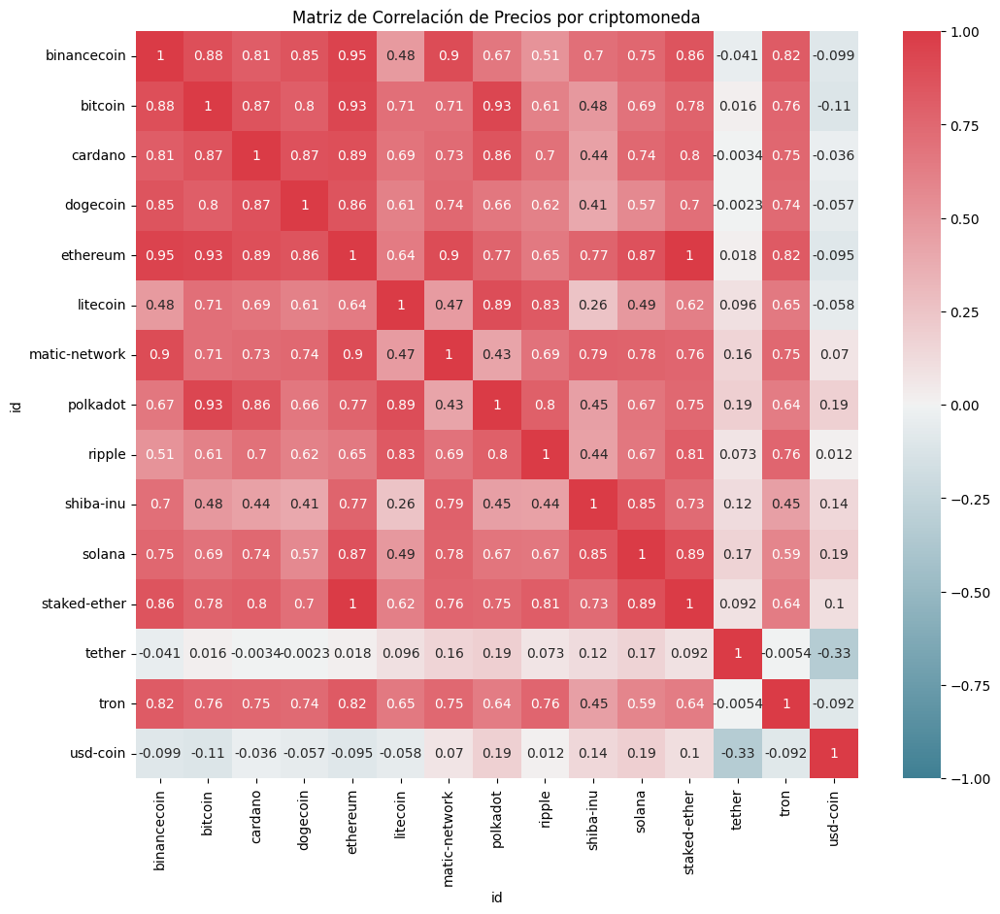

In [ ]:
pivot_data = data.pivot(index='date', columns='id', values='price_value')
correlation_matrix=pivot_data.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap=sns.diverging_palette(220, 10, as_cmap=True), vmin=-1, vmax=1)
plt.title('Matriz de Correlación de Precios por criptomoneda')
plt.show()

### 15.2 Correlación entre la capitalización del mercado de las criptomonedas.

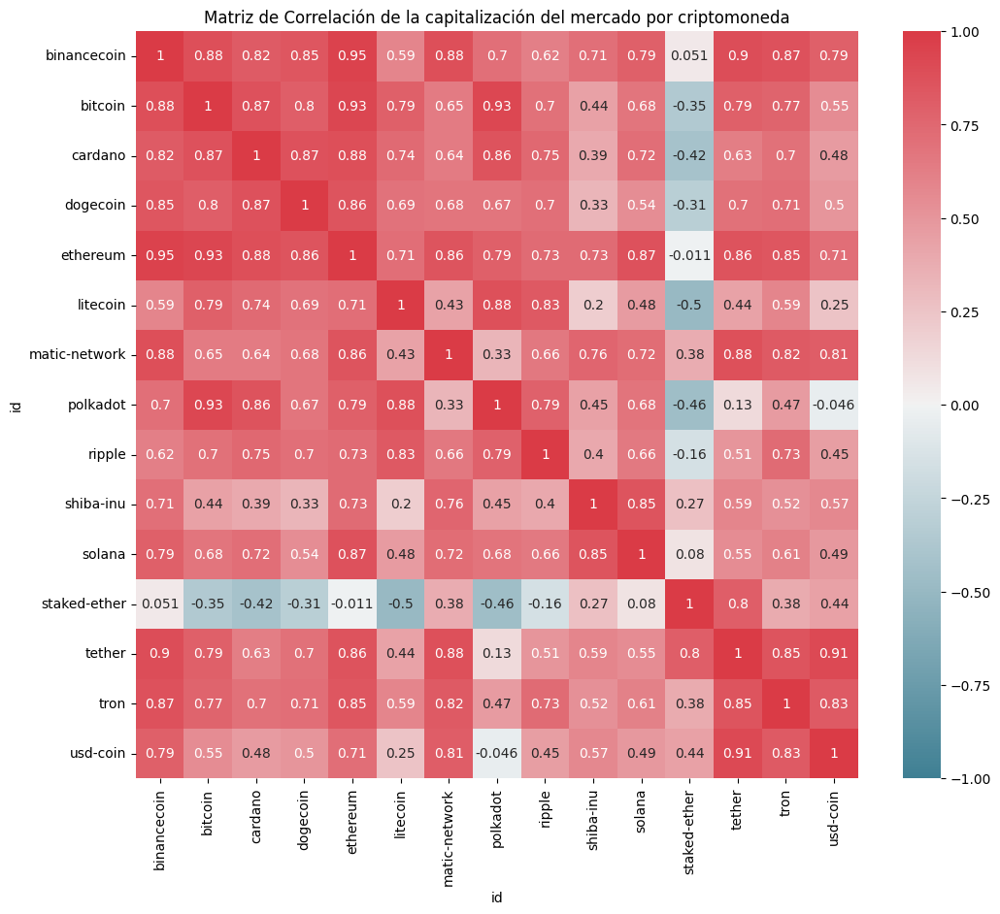

In [ ]:
pivot_data = data.pivot(index='date', columns='id', values='market_cap_value')
correlation_matrix=pivot_data.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap=sns.diverging_palette(220, 10, as_cmap=True), vmin=-1, vmax=1)
plt.title('Matriz de Correlación de la capitalización del mercado por criptomoneda')
plt.show()

### 15.3 Correlación entre el volúmen de las criptomonedas.

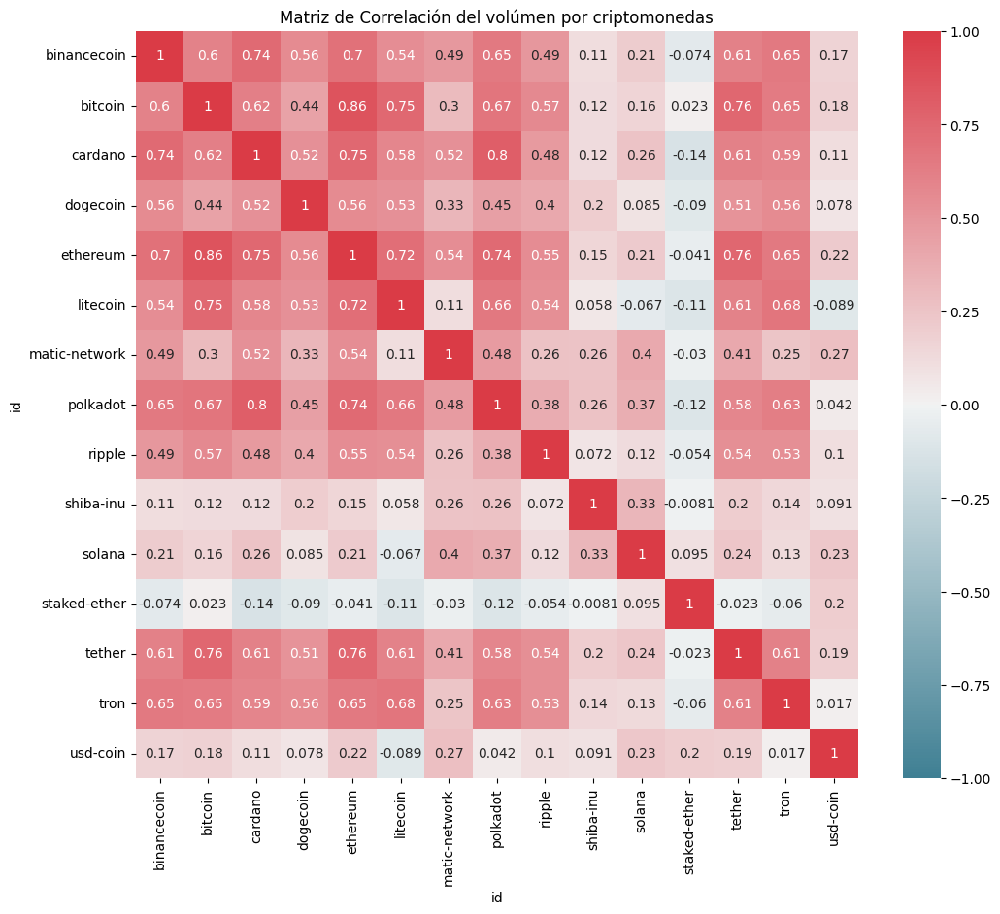

In [ ]:
pivot_data = data.pivot(index='date', columns='id', values='volume_value')
correlation_matrix=pivot_data.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap=sns.diverging_palette(220, 10, as_cmap=True), vmin=-1, vmax=1)
plt.title('Matriz de Correlación del volúmen por criptomonedas')
plt.show()

### Descripción
Con la premicia que a mayor el número de la correlación se aproxime al valor 1 , mayor correlación tendrán las criptomonedas respecto a las variables.

**1. Precios:** Las monedas que tienen mayor correlación entre sí respecto a los precios son binancecoin con ethereum (en un 0.95 de correlación), bitcoin con ethereum y polkadot (en un 0.93 de correlación) y usd-coin con tether (con una correlación negativa de -0.33).

**2. Capitalización del mercado:** Las monedas que tienen mayor correlación entre sí respecto a la capitalización del mercado son binancecoin con ethereum (en un 0.95 de correlación), bitcoin con ethereum y polkadot (en un 0.93 de correlación), tether con usd-coin (en un 0.91 de correlación) y staked-ether con litecoin (con una correlación negativa de -0.5)

**3. Volúmen:** Las monedas que tienen mayor correlación entre sí respecto al volúmen son bitcoin con ethereum (en un 0.86 de correlación) y polkadot con cardano (en un 0.8 de correlación).

[*Link de referencia*]("https://blockworks.co/news/the-investors-guide-to-crypto-correlation")

## 16. Observamos las correlaciones entre distintas variables

### 16.1 Correlación entre el precio y capitalización del mercado

In [ ]:
# Ajustamos el tamaño de la visualización
fig_height = 800

# Creamos subplots 
rows = 5  
cols = 3  
subplot_titles = [f'{id}' for id in unique_ids]
fig = sp.make_subplots(rows=rows, cols=cols, subplot_titles=subplot_titles, shared_xaxes=False,horizontal_spacing=0.1, vertical_spacing=0.1,
                        column_widths=[0.3, 0.3, 0.3], row_heights=[fig_height // rows] * rows)

# Agregamos los trazoss a los subplots
for i, subplot_id in enumerate(unique_ids, start=1):
    row = (i - 1) // cols + 1
    col = (i - 1) % cols + 1
    filtered_data = data[data['id'] == subplot_id]
    trace = go.Scatter(x=filtered_data['price_value'],y=filtered_data['market_cap_value'], mode='markers', line=dict(color='#0B666A'))
    fig.add_trace(trace, row=row, col=col)

    # Actualizamos las etiquetas de los ejes
    fig.update_xaxes(title_text='Precio', row=row, col=col)
    fig.update_yaxes(title_text='Capital de Mercado', row=row, col=col)

# Eliminamos la leyenda
fig.update_layout(title='Correlación entre el precio y la capitalización de mercado',title_font_size=20, height=200*num_rows, showlegend=False)

# Mostramos el gráfico
fig.show()

### 16.2 Correlación entre el precio y volúmen

In [ ]:
# Ajustamos el tamaño de la visualización
fig_height = 800

# Creamos subplots 
rows = 5  
cols = 3  
subplot_titles = [f'{id}' for id in unique_ids]
fig = sp.make_subplots(rows=rows, cols=cols, subplot_titles=subplot_titles, shared_xaxes=False,horizontal_spacing=0.1, vertical_spacing=0.1,
                        column_widths=[0.3, 0.3, 0.3], row_heights=[fig_height // rows] * rows)

# Agregamos los trazoss a los subplots
for i, subplot_id in enumerate(unique_ids, start=1):
    row = (i - 1) // cols + 1
    col = (i - 1) % cols + 1
    filtered_data = data[data['id'] == subplot_id]
    trace = go.Scatter(x=filtered_data['price_value'],y=filtered_data['volume_value'], mode='markers', line=dict(color='#0B666A'))
    fig.add_trace(trace, row=row, col=col)

    # Actualizamos las etiquetas de los ejes
    fig.update_xaxes(title_text='Precio', row=row, col=col)
    fig.update_yaxes(title_text='Volúmen', row=row, col=col)

# Eliminamos la leyenda
fig.update_layout(title='Correlación entre precio y volúmen por criptomoneda',title_font_size=20, height=200*num_rows, showlegend=False)

# Mostramos el gráfico
fig.show()

### 16.3 Correlación entre la capitalización del mercado y volúmen

In [ ]:
# Ajustamos el tamaño de la visualización
fig_height = 800

# Creamos subplots 
rows = 5  
cols = 3  
subplot_titles = [f'{id}' for id in unique_ids]
fig = sp.make_subplots(rows=rows, cols=cols, subplot_titles=subplot_titles, shared_xaxes=False,horizontal_spacing=0.1, vertical_spacing=0.1,
                        column_widths=[0.3, 0.3, 0.3], row_heights=[fig_height // rows] * rows)

# Agregamos los trazoss a los subplots
for i, subplot_id in enumerate(unique_ids, start=1):
    row = (i - 1) // cols + 1
    col = (i - 1) % cols + 1
    filtered_data = data[data['id'] == subplot_id]
    trace = go.Scatter(x=filtered_data['market_cap_value'],y=filtered_data['volume_value'], mode='markers', line=dict(color='#0B666A'))
    fig.add_trace(trace, row=row, col=col)

    # Actualizamos las etiquetas de los ejes
    fig.update_xaxes(title_text='Capitalización del mercado', row=row, col=col)
    fig.update_yaxes(title_text='Volúmen', row=row, col=col)

# Eliminamos la leyenda
fig.update_layout(title='Correlación entre la capitalización del mercado y el volúmen por criptomoneda',title_font_size=20, height=200*num_rows, showlegend=False)

# Mostramos el gráfico
fig.show()

### Descripción
**1. Precio y capitalización de mercado:** Casi la mayoría de las criptomonedas tomadas tienen una correlación con tendencia positiva de las variables precio y capitalización de mercado a exepción de las criptomonedas tether, staked-ether, usd-coin. Que la correlación tenga una tendencia positiva implica que hubo mayor demanda de esa criptomoneda, las condiciones económicas fueron propisicias para realizar intercambios entre esa moneda, las regulaciones y políticas monetarias ayudaron a que esa criptomoneda pueda desenvolverse mejor. Las hace más atractivas en el mercado de activos financieros.

**2. Precio y volúmen:** El comportamiento de todas las criptomonedas en referencia a la correlación con las variables precio y volúmen, indican que no existe una correlación entre estas, por lo que en el gráfico aparecen los puntos muy dispersos y no se observa una tendencia.

**3. Capitalización del mercado y volúmen:** El comportamiento de todas las criptomonedas en referencia a la correlación con las variables capitalización del mercado y volúmen, indican que no existe una correlación entre estas, por lo que en el gráfico aparecen los puntos muy dispersos y no se observa una tendencia.

[*Link de referencia*]("https://www.investopedia.com/news/are-bitcoin-price-and-equity-markets-returns-correlated/")